In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import scanorama as sca
import scib
import scvi
import harmonypy
import pymn
import scrublet as scr
import gseapy as gp
from gseapy.plot import barplot, dotplot

/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/torch/utils/tensorboard/__init__.py:4: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if not hasattr(tensorboard, "__version__") or LooseVersion(
/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/torch/utils/tensorboard/__init__.py:6: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  ) < LooseVersion("1.15"):
Global seed set to 0
/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/chex/_src/pytypes.py:37: FutureWarning: jax.tree_structure is deprecated, and will be removed in a future release. Use jax.tree_util.tree_structure instead.
  PyTreeDef = type(jax.tree_structure(None))
/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/pyMetaNeighbor-0.1.0-py3.9.egg/pymn/trainModel.py:29: SyntaxWarning: "is not" with a literal. Did you mean "!="?
/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/pyMetaNeighbor-0.1.0-py3.9.egg/pymn/trai

In [2]:
sc.set_figure_params(dpi=300, color_map = 'viridis_r' )
sc.settings.verbosity = 2

/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


In [3]:
%load_ext rpy2.ipython

In [4]:
preindex_136 = pd.read_csv('preindex_136.csv')

In [5]:
# https://github.com/JonathanShor/DoubletDetection
# https://github.com/swolock/scrublet/blob/master/examples/scrublet_basics.ipynb

# loading & Batch QC

In [21]:
sample='BRCA_p1_NAT_gene_batch_1'

tag='gene'

chip_1='E100058585'
lib_1='46'

#preindex_set_1=preindex_136[:16]['barcode'].tolist()
preindex_set_1=preindex_136[32:48]['barcode'].tolist()

In [22]:
if tag == 'exon':
    adata_raw_1=sc.read('/mnt/hdd1/jikai/matq_pan_cancer_dge_raw/'+chip_1+'/'+lib_1+'/processed/dge/exon_only/counts.tsv')
else:
    adata_raw_1=sc.read('/mnt/hdd1/jikai/matq_pan_cancer_dge_raw/'+chip_1+'/'+lib_1+'/processed/dge/counts.tsv')
    
adata_raw_1 = adata_raw_1.transpose()
barcode_1=pd.DataFrame(adata_raw_1.obs.index.tolist())
barcode_1['preindex']=barcode_1[0].str[-10:]
preindex_1=np.unique(barcode_1['preindex'].tolist())

if tag == 'exon':
    umigenecounts_1 = pd.read_csv('/mnt/hdd1/jikai/matq_pan_cancer_dge_raw/'+chip_1+'/'+lib_1+'/processed/dge/exon_only/UMI_Gene_count_sorted.tsv',sep='\t',header = None, names = ['read','umi','gene'] )
else:
    umigenecounts_1 = pd.read_csv('/mnt/hdd1/jikai/matq_pan_cancer_dge_raw/'+chip_1+'/'+lib_1+'/processed/dge/UMI_Gene_count_sorted.tsv',sep='\t',header = None, names = ['read','umi','gene'] )

In [23]:
adata_cell_1=barcode_1[barcode_1["preindex"].isin(preindex_set_1)][0].tolist()
adata_raw_1=adata_raw_1[adata_cell_1,:]
adata_raw_1.obs['lib']=lib_1
adata_raw_1.obs['chip']=chip_1
adata_raw_1

adata_index_1=pd.DataFrame(adata_raw_1.obs.index.tolist())
adata_index_1.index=adata_index_1[0]
adata_index_1['read']=0
for i in adata_index_1.index.tolist():
    adata_index_1.loc[i, 'read']=umigenecounts_1.loc[i, 'read']
adata_raw_1.obs['total_reads']=adata_index_1['read']

/tmp/ipykernel_664461/2909502352.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_raw_1.obs['lib']=lib_1


In [33]:
adata=adata_raw_1.copy()

adata.obs.index=adata.obs.index+'_'+adata.obs['chip']+'_'+adata.obs['lib']

adata

AnnData object with n_obs × n_vars = 11957 × 34460
    obs: 'lib', 'chip', 'total_reads'

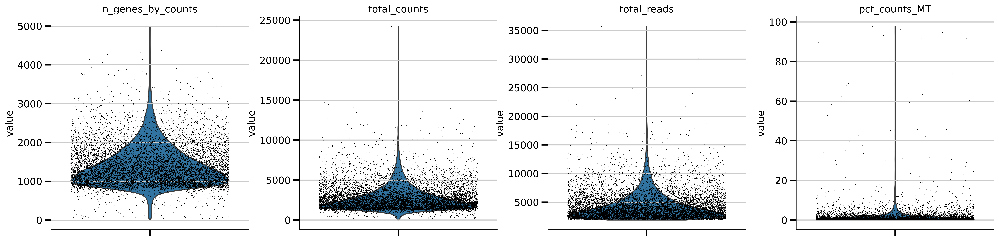

In [34]:
###### Calculate genes&counts&mt proportion,change for MT if human
adata.var['MT'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['MT'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'total_reads', 'pct_counts_MT'], jitter=0.4, multi_panel=True, save = '_no_QC_'+sample+'.png')

filtered out 257 cells that have less than 700 genes expressed
filtered out 5 cells that have more than 15000 counts
filtered out 17345 genes that are detected in less than 29.2375 cells


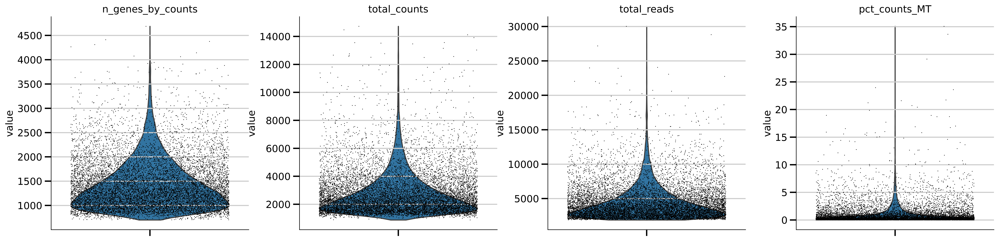

In [35]:
###Filter
# A guideline to setting this threshold is to use the minimum cell cluster size that is of interest and leaving some leeway for dropout effects. For example, filtering out genes expressed in fewer than 20 cells may make it difficult to detect cell clusters with fewer than 20 cells.
# https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6582955/
sc.pp.filter_cells(adata, min_genes=700)
sc.pp.filter_cells(adata, min_counts=800)
sc.pp.filter_cells(adata, max_counts=15000)
sc.pp.filter_genes(adata, min_cells=(adata.shape[0]*0.0025))
#sc.pp.filter_genes(adata, min_counts=200)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'total_reads', 'pct_counts_MT'], jitter=0.4, multi_panel=True, save = '_after_QC_'+sample+'.png')

/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


normalizing counts per cell
    finished (0:00:00)


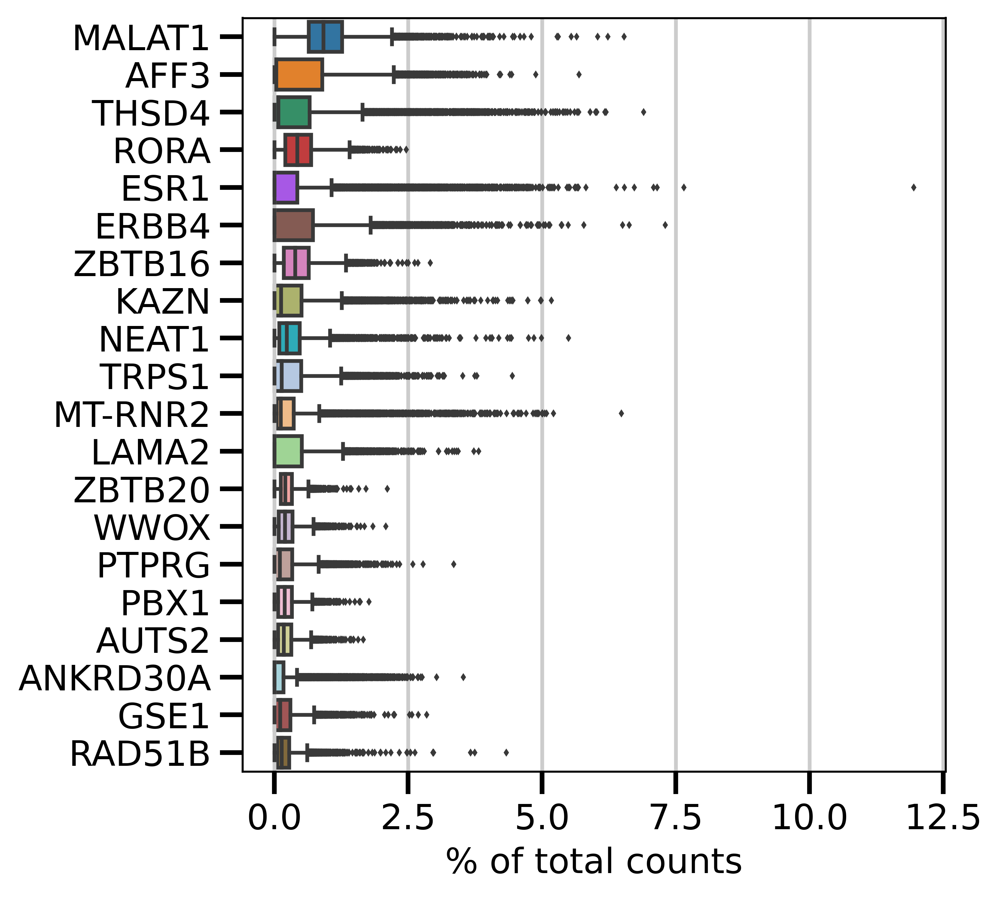

In [36]:
adata = adata[adata.obs.pct_counts_MT < 10, :]
sc.pp.calculate_qc_metrics(adata, percent_top=None, inplace=True)
sc.pl.highest_expr_genes(adata, n_top=20, save = 'top20_'+sample+'.png')

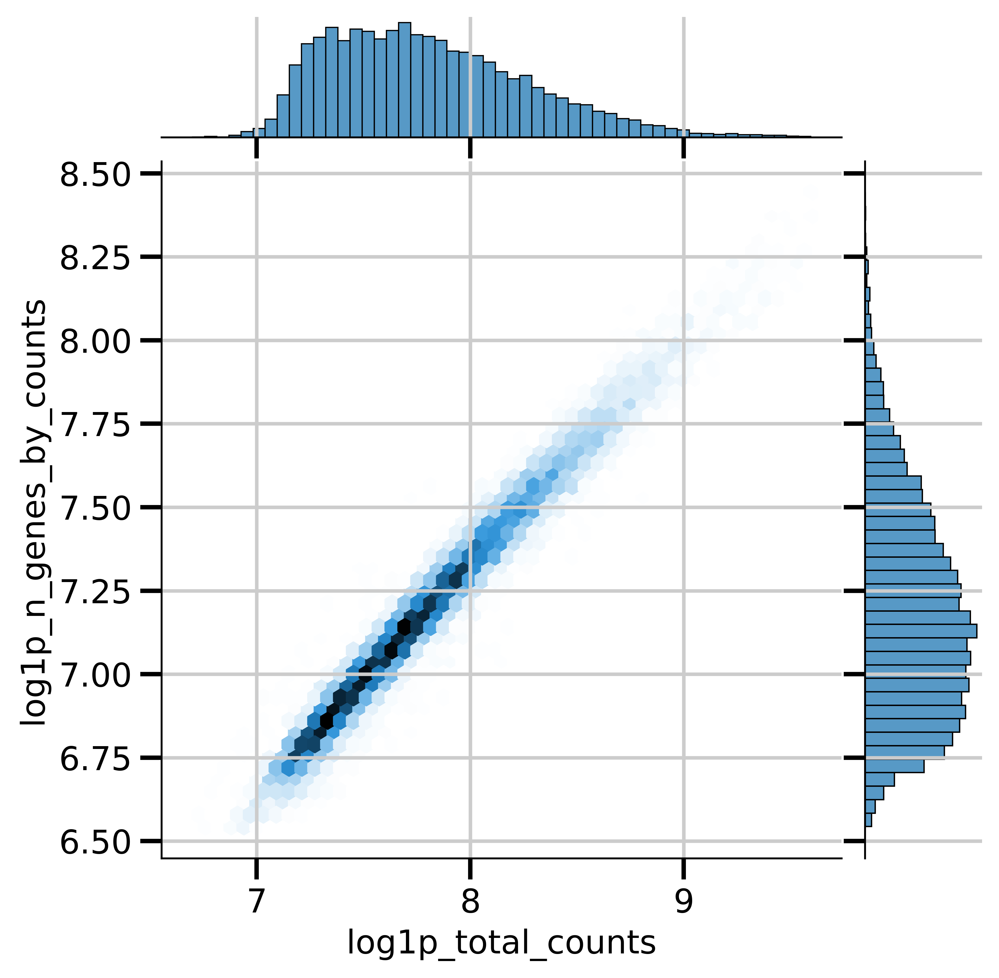

In [37]:
sns.jointplot(data=adata.obs, x="log1p_total_counts", y="log1p_n_genes_by_counts", kind="hex")
plt.savefig('figures/lognormcount_'+sample+'.png', dpi=300)

In [38]:
adata.obs['sample']=sample
adata.write(str(sample) + '_QC_raw.h5ad')
sample

'BRCA_p1_NAT_gene_batch_1'

# Loading DGE 

In [40]:
sample='BRCA_p1_tumor_gene_batch_1'
BRCA_p1_tumor_gene_batch_1=sc.read(str(sample) + '_QC_raw.h5ad')
BRCA_p1_tumor_gene_batch_1

AnnData object with n_obs × n_vars = 450 × 14628
    obs: 'lib', 'chip', 'total_reads', 'n_genes_by_counts', 'total_counts', 'total_counts_MT', 'pct_counts_MT', 'n_genes', 'n_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'sample'
    var: 'MT', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'log1p_mean_counts', 'log1p_total_counts'

In [39]:
sample='BRCA_p1_NAT_gene_batch_1'
BRCA_p1_NAT_gene_batch_1=sc.read(str(sample) + '_QC_raw.h5ad')
BRCA_p1_NAT_gene_batch_1

AnnData object with n_obs × n_vars = 11627 × 17115
    obs: 'lib', 'chip', 'total_reads', 'n_genes_by_counts', 'total_counts', 'total_counts_MT', 'pct_counts_MT', 'n_genes', 'n_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'sample'
    var: 'MT', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'log1p_mean_counts', 'log1p_total_counts'

# Combined DGE

In [43]:
adata_combined=sc.AnnData.concatenate(BRCA_p1_tumor_gene_batch_1, BRCA_p1_NAT_gene_batch_1, join="outer", fill_value=0, index_unique=None)
del adata_combined.obs['batch']
del adata_combined.var
adata_combined.write('BRCA_p1_gene_combined_raw.h5ad')

# LogNormalized & MT Excluded DGE

In [53]:
adata_combined=sc.read('BRCA_p1_gene_combined_raw.h5ad')
adata=adata_combined.copy()

sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

mt_gene=[s for s in adata.var.index.tolist() if s.startswith('MT-')]
mt_excluded=list(set(adata.var.index.tolist()).difference(set(mt_gene)))
adata = adata[:, mt_excluded]

adata.write('BRCA_p1_gene_combined_lognormal_noMT.h5ad')

normalizing counts per cell
    finished (0:00:00)


# Clustering for each batch

In [45]:
adata_combined=sc.read('BRCA_p1_gene_combined_raw.h5ad')

In [46]:
adata=adata_combined.copy()
pc_select=40
res=0.4

batch_list = adata.obs['sample'].cat.categories.tolist()
alldata = []

for batch in batch_list:
    alldata.append(adata[adata.obs['sample'] == batch])

normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:05)


/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


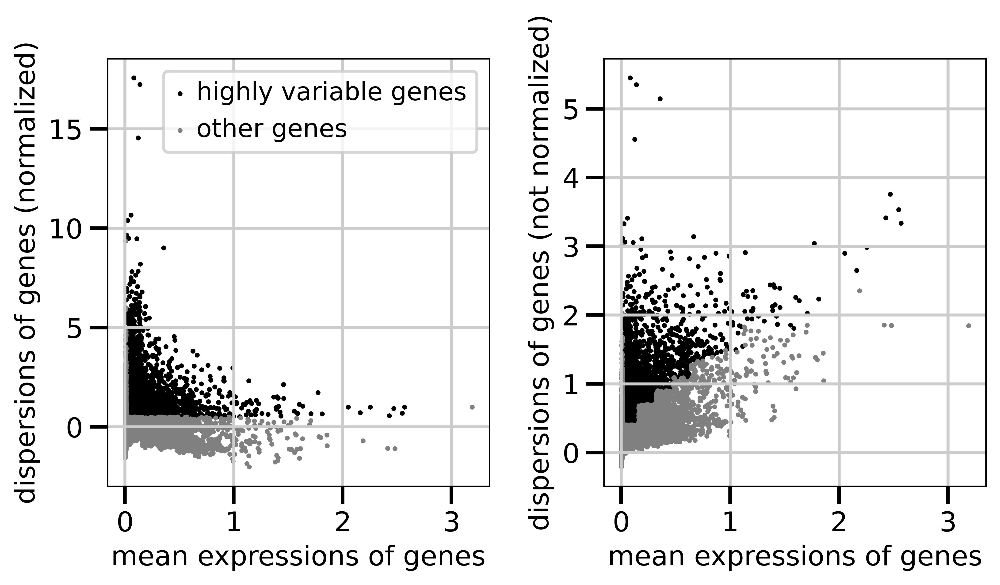

regressing out ['total_counts']


/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/statsmodels/compat/pandas.py:12: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  version = LooseVersion(pd.__version__)
/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/statsmodels/compat/pandas.py:14: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  pandas_lt_1_0_0 = version < LooseVersion('1.0.0')
/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/statsmodels/compat/pandas.py:15: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  pandas_lt_25_0 = version < LooseVersion('0.25.0')
/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/statsmodels/compat/pandas.py:16: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  pandas_gte_23_0 = version >= LooseVersion('0.23.0')
/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/statsmodels/compat/scipy.py

    finished (0:00:23)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


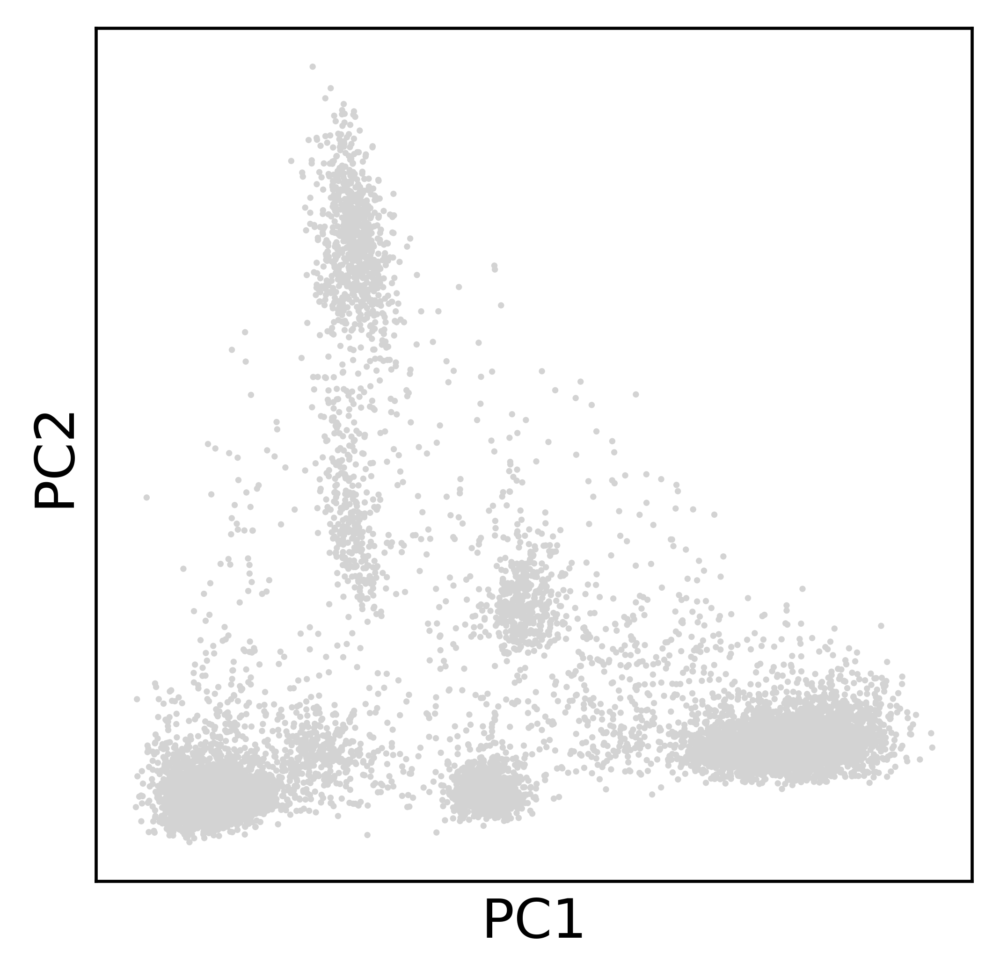

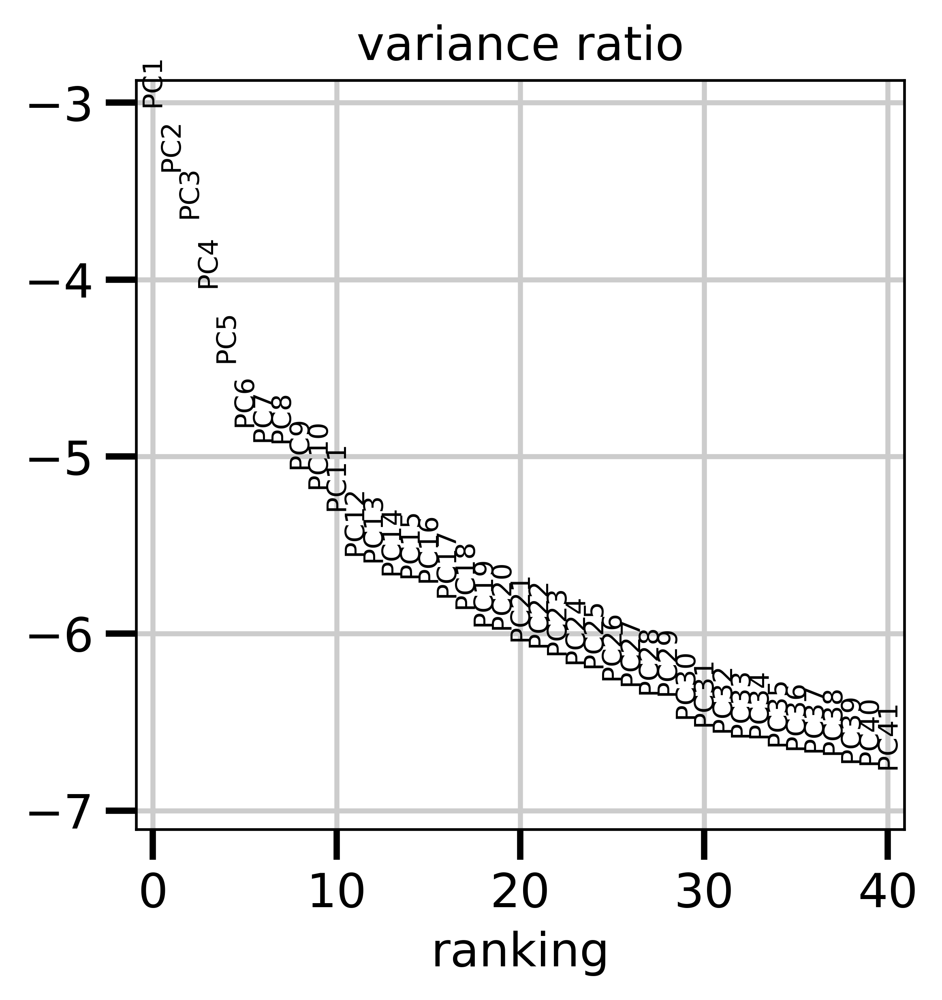

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished (0:00:22)
running Leiden clustering
    finished (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished (0:00:21)
computing UMAP
    finished (0:00:05)


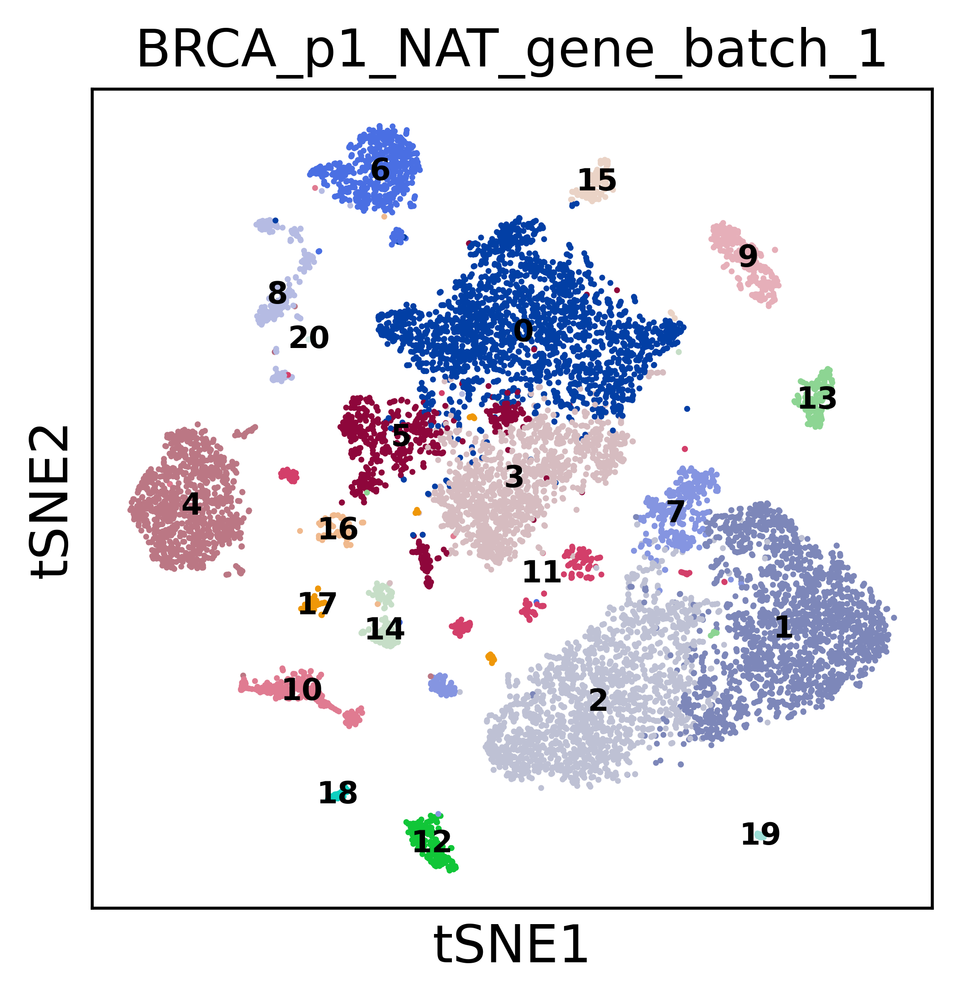

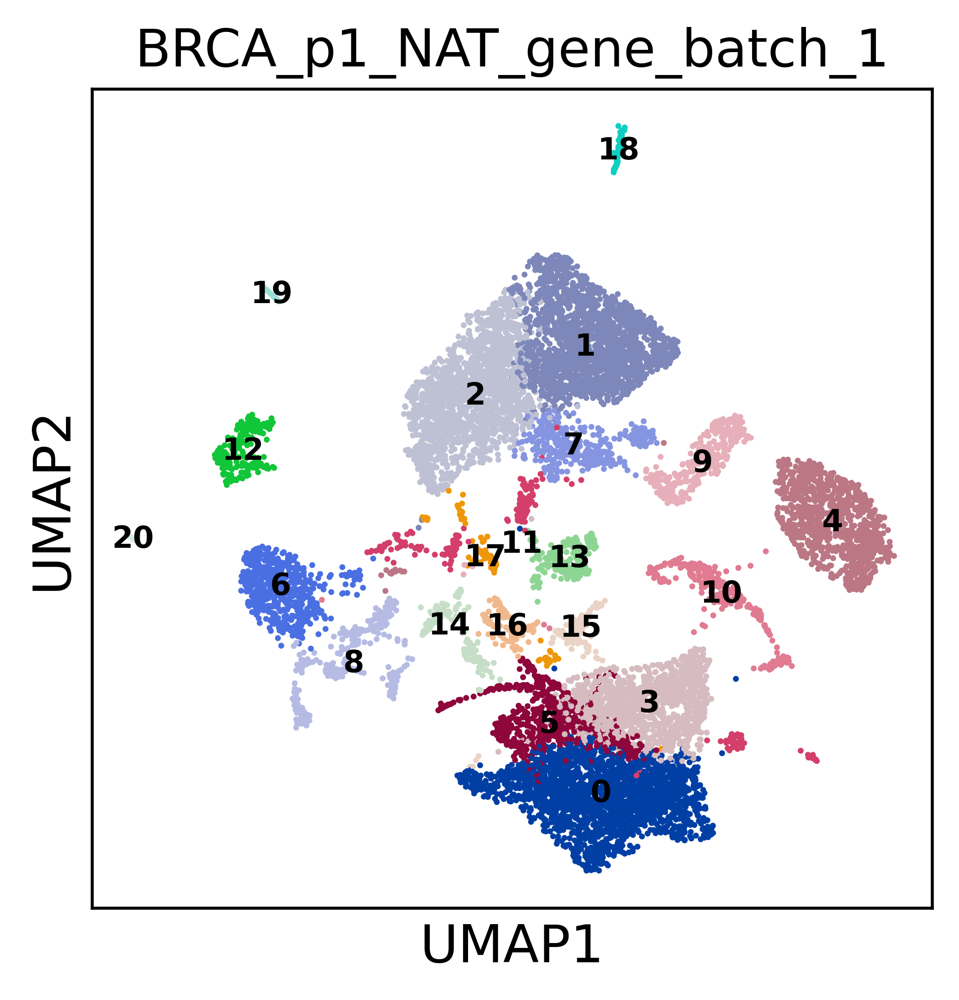

ranking genes
    finished (0:00:07)


/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


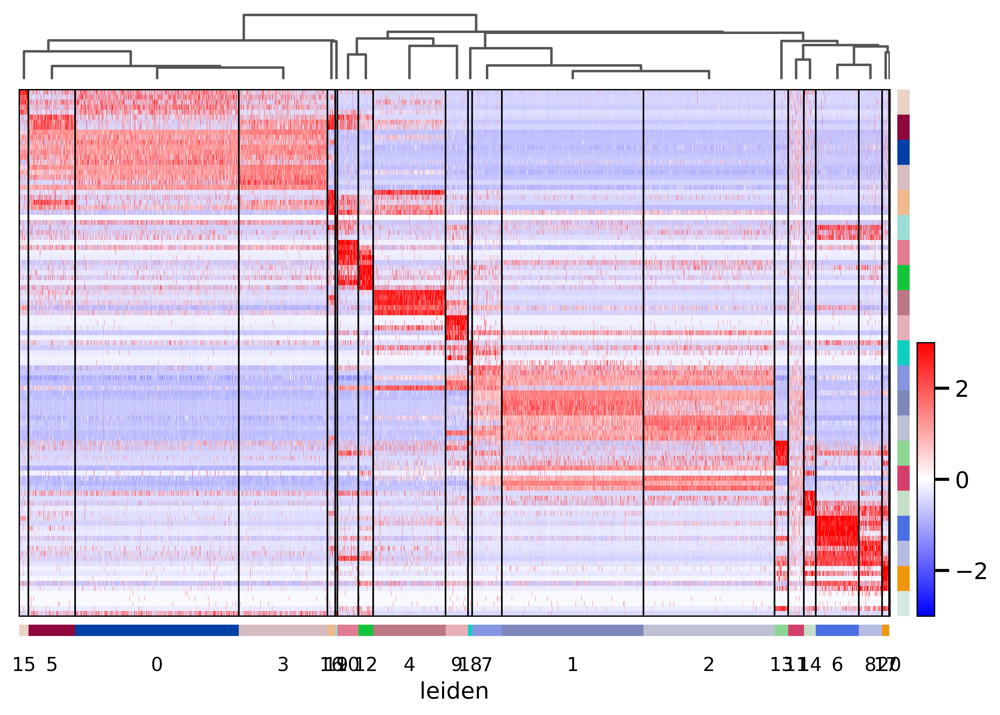

normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)


/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


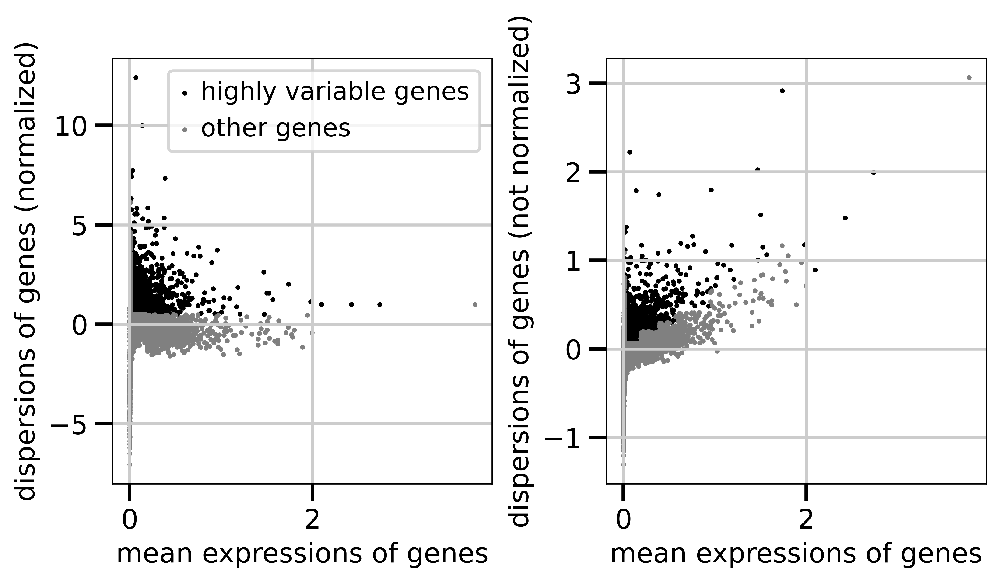

regressing out ['total_counts']
    finished (0:00:06)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


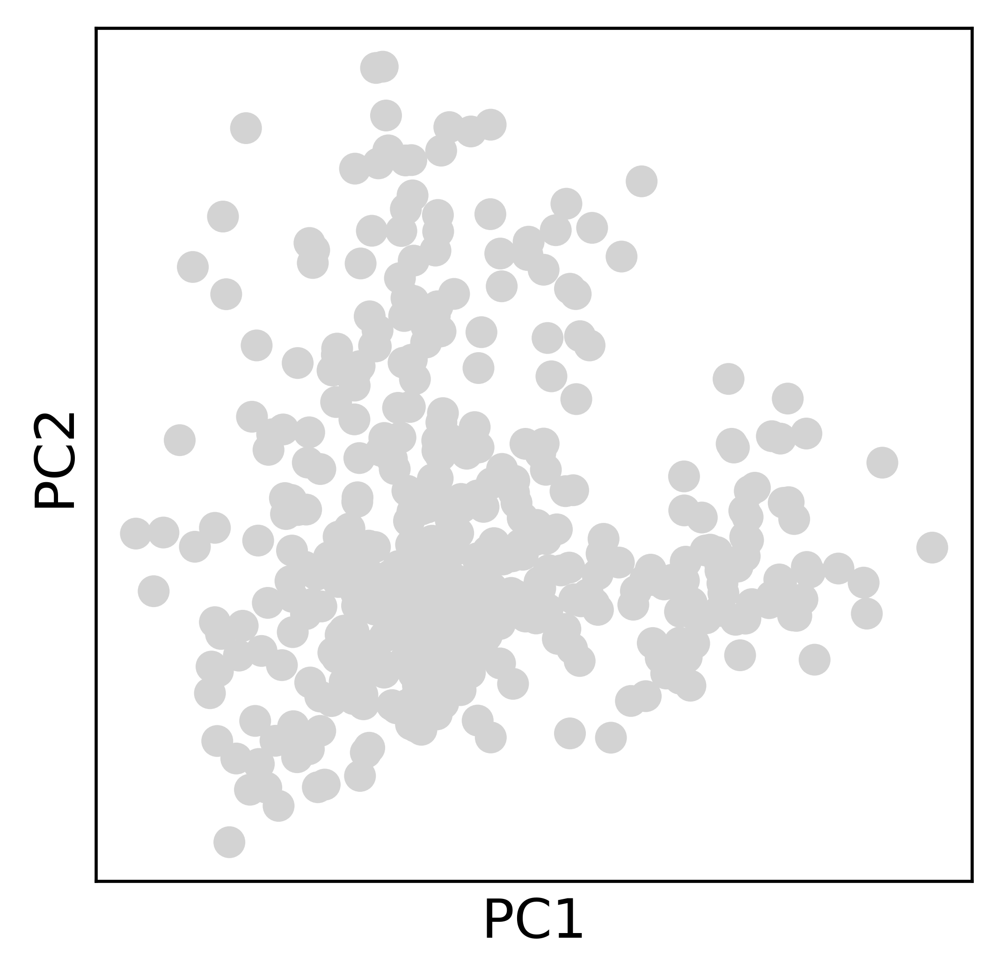

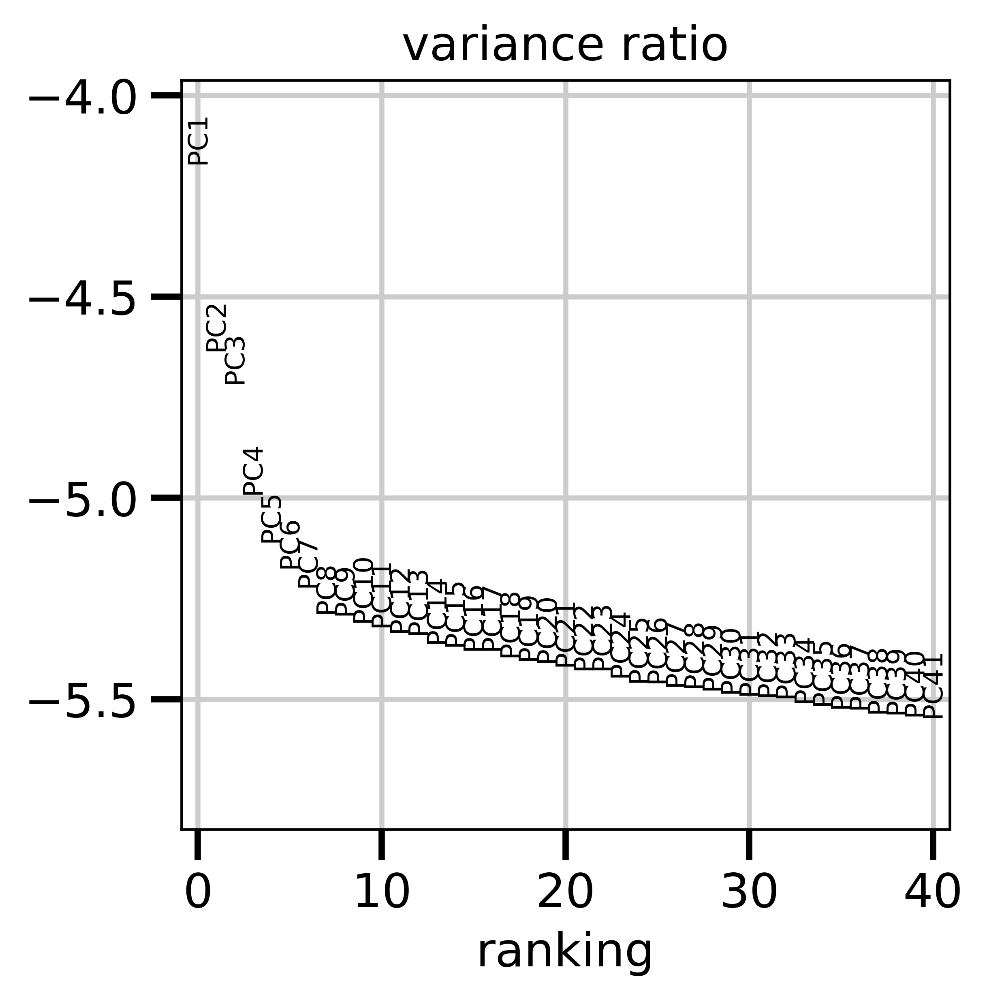

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished (0:00:00)
computing UMAP
    finished (0:00:01)


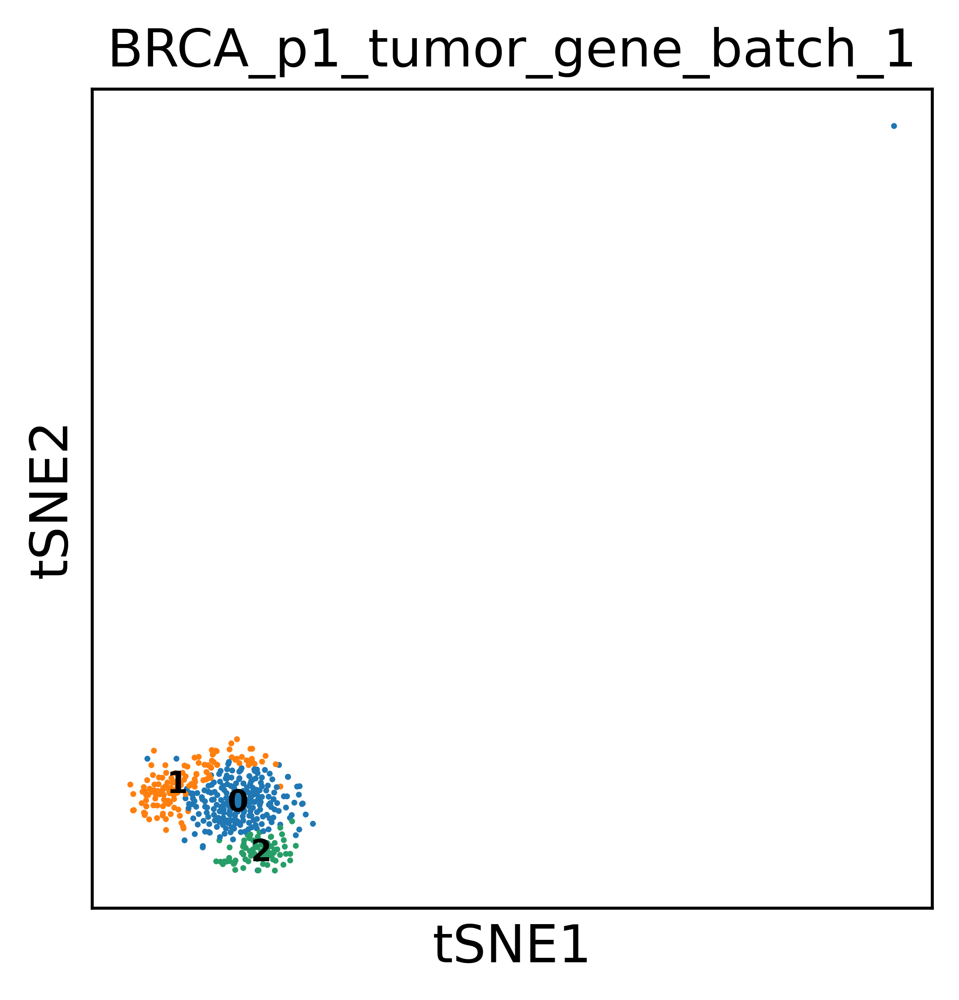

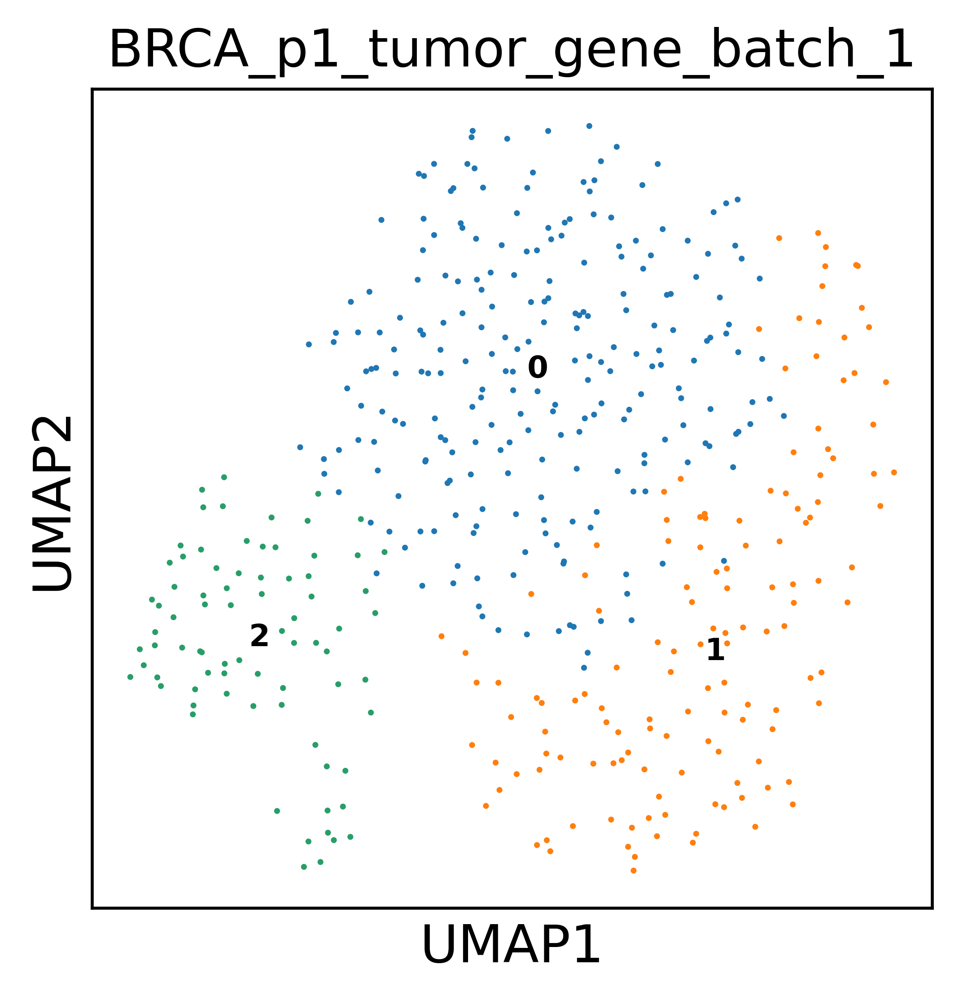

ranking genes
    finished (0:00:00)


/mnt/hdd1/tools/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


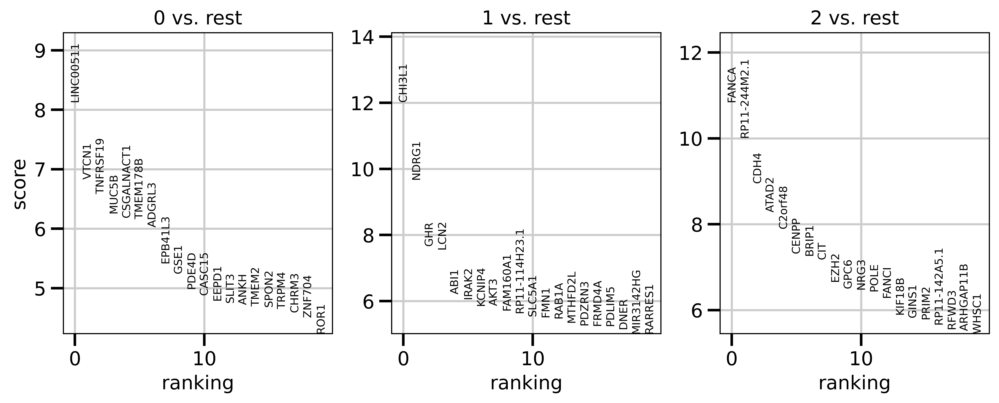

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


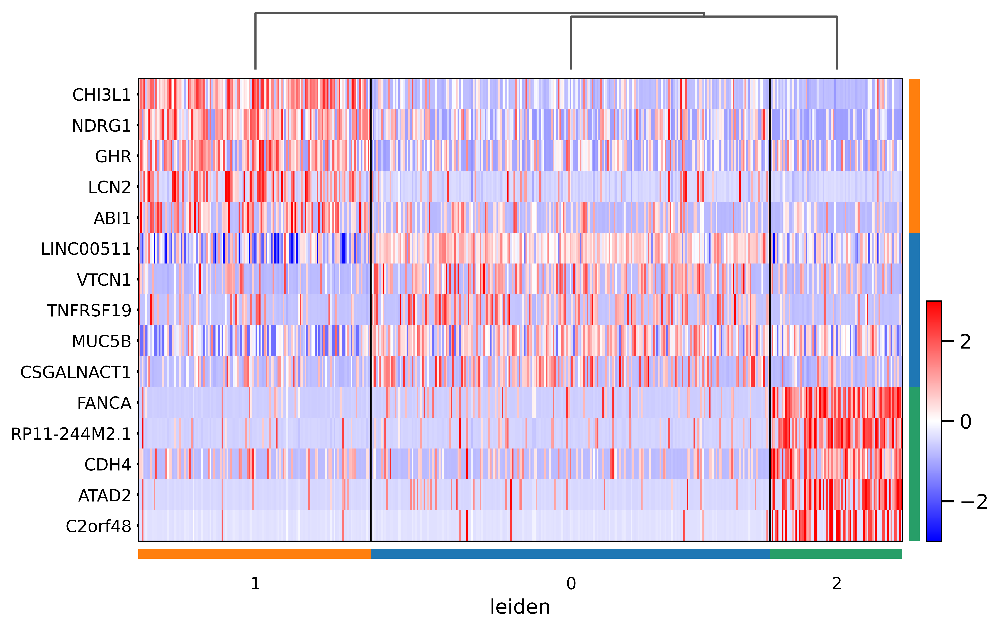

In [47]:
for each_adata in alldata:
    
    each_sample=''.join(each_adata.obs['sample'].cat.categories.tolist())
    
    adata=each_adata.copy()
    
    adata_raw=adata.copy()
    adata_raw.raw=adata
    
    sc.pp.normalize_total(adata)
    sc.pp.log1p(adata)    
    sc.pp.normalize_total(adata_raw)
    sc.pp.log1p(adata_raw)
    
    mt_gene = [s for s in adata.var.index.tolist() if s.startswith('MT-')]
    mt_excluded=list(set(adata.var.index.tolist()).difference(set(mt_gene)))
    adata = adata[:, mt_excluded]
    
    sc.pp.highly_variable_genes(adata)
    sc.pl.highly_variable_genes(adata, save = '_'+each_sample+'.png')
    adata = adata[:, adata.var.highly_variable]
    
    sc.pp.regress_out(adata, ['total_counts'])
    sc.pp.scale(adata)
    sc.tl.pca(adata, svd_solver='arpack')
    sc.pl.pca(adata, save = '_'+each_sample+'.png')
    sc.pl.pca_variance_ratio(adata, n_pcs=pc_select, log=True, save = '_'+each_sample+'.png')

    sc.pp.neighbors(adata, n_neighbors=10, n_pcs=pc_select)
    sc.tl.leiden(adata, resolution=res)
    sc.tl.tsne(adata)
    sc.tl.umap(adata)
    
    sc.pl.tsne(adata, color='leiden', size=10, legend_fontsize='xx-small', legend_loc= 'on data', save = '_leiden_'+each_sample+'.png', title=each_sample)
    sc.pl.umap(adata, color='leiden', size=10, legend_fontsize='xx-small', legend_loc= 'on data', save = '_leiden_'+each_sample+'.png', title=each_sample)
    
    sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
    sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, save = '_'+each_sample+'.png')
    df_rank_genes_groups = pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(200)
    df_rank_genes_groups = df_rank_genes_groups.add_prefix('Leiden_')
    df_rank_genes_groups.to_csv(each_sample+'_marker.csv')
    sc.pl.rank_genes_groups_heatmap(adata, n_genes=5, use_raw=False, swap_axes=True, vmin=-3, vmax=3, cmap='bwr', figsize=(10,7), save='_'+each_sample+'.png')
    adata_raw.var['highly_variable'] = [True if gene in adata.var_names else False for gene in adata_raw.var_names]
    adata_raw.obs['leiden']=adata.obs['leiden']

    adata_raw.uns['dendrogram_leiden']=adata.uns['dendrogram_leiden']
    adata_raw.uns['hvg']=adata.uns['hvg']
    adata_raw.uns['leiden']=adata.uns['leiden']
    adata_raw.uns['leiden_colors']=adata.uns['leiden_colors']
    adata_raw.uns['neighbors']=adata.uns['neighbors']
    adata_raw.uns['pca']=adata.uns['pca']
    adata_raw.uns['rank_genes_groups']=adata.uns['rank_genes_groups']
    adata_raw.uns['tsne']=adata.uns['tsne']
    adata_raw.uns['umap']=adata.uns['umap']

    adata_raw.obsm['X_pca']=adata.obsm['X_pca']
    adata_raw.obsm['X_tsne']=adata.obsm['X_tsne']
    adata_raw.obsm['X_umap']=adata.obsm['X_umap']

    adata_raw.obsp['connectivities']=adata.obsp['connectivities']
    adata_raw.obsp['distances']=adata.obsp['distances']

    adata_raw.write(str(each_sample) + '.h5ad')

# Double Check

In [48]:
sample='BRCA_p1'
adata=sc.read(sample+'_gene_combined_raw.h5ad')

In [49]:
adata.obs['chip']=adata.obs['chip'].astype(str)
adata.obs['lib']=adata.obs['lib'].astype(str)
adata.obs['sample']=adata.obs['sample'].astype(str)
adata.obs['batch_name']=adata.obs['chip']+'_'+adata.obs['lib']+'_'+adata.obs['sample']
adata.obs['batch_name'].value_counts()

E100058585_46_BRCA_p1_NAT_gene_batch_1      11627
E100058585_44_BRCA_p1_tumor_gene_batch_1      450
Name: batch_name, dtype: int64

In [50]:
preindex_set_1=preindex_136[:16]['barcode'].tolist()
adata.obs['ID']=adata.obs.index
adata.obs['ID_only']=adata.obs['ID'].str.split('_', expand=True)[0]
adata.obs['preindex']=adata.obs['ID_only'].str[-10:]
len(list(set(np.unique(adata.obs['preindex'].tolist())).intersection(set(preindex_set_1))))

15

In [51]:
preindex_set_1=preindex_136[32:48]['barcode'].tolist()
adata.obs['ID']=adata.obs.index
adata.obs['ID_only']=adata.obs['ID'].str.split('_', expand=True)[0]
adata.obs['preindex']=adata.obs['ID_only'].str[-10:]
len(list(set(np.unique(adata.obs['preindex'].tolist())).intersection(set(preindex_set_1))))

16

In [52]:
len(np.unique(adata.obs['preindex'].tolist()))

31